In [1]:
# Sbi
import sbi
from sbi.utils.get_nn_models import likelihood_nn
from sbi.analysis import pairplot
from sbi import inference
from sbi.vi.divergence_optimizers import ElboOptimizer
from sbi.vi.mixture_of_flows import MixtureFullGaussians, Mixture

# Sbi benchmark
import sbibm
from sbibm.metrics import c2st

# torch and so
import torch
from torch.distributions import Categorical
from torch.distributions.transforms import ComposeTransform
from torch import nn
import numpy as np

import matplotlib.pyplot as plt

In [2]:
# Loads a model...
def get_model(task_name):
    task = sbibm.get_task(task_name) 
    prior = task.prior_dist
    # 
    # simulator = task.get_simulator()
    # observation = task.get_observation(num_observation=1) 

    # thetas = prior.sample((10000,))
    # xs = simulator(thetas)
    thetas = task.get_reference_posterior_samples(1)
    xs = torch.zeros((thetas.shape[0],20))

    inf = inference.SNLVI(prior)
    density_estimator = inf.append_simulations(thetas, xs).train(max_num_epochs=0)
    state_dict = torch.load(f"scripts/likelihood_models/{task_name}.net")
    inf._neural_net = state_dict
    #density_estimator = inf._neural_net
    #density_estimator.load_state_dict(state_dict)
    return inf, task

In [3]:
# Loads a model...
def get_model(task_name):
    task = sbibm.get_task(task_name) 
    prior = task.prior_dist
    simulator = task.get_simulator()
    observation = task.get_observation(num_observation=1) 

    thetas = prior.sample((10000,))
    xs = simulator(thetas)


    inf = inference.SNLVI(prior)
    density_estimator = inf.append_simulations(thetas, xs).train(max_num_epochs=0)
    state_dict = torch.load(f"scripts/likelihood_models/{task_name}.net")
    density_estimator = inf._neural_net
    density_estimator.load_state_dict(state_dict())
    return inf, task

In [4]:
inf, task = get_model("slcp")

D:\Anaconda3\lib\site-packages\pyro\distributions\torch_patch.py:81: UserWarning: torch.symeig is deprecated in favor of torch.linalg.eigh and will be removed in a future PyTorch release.
The default behavior has changed from using the upper triangular portion of the matrix by default to using the lower triangular portion.
L, _ = torch.symeig(A, upper=upper)
should be replaced with
L = torch.linalg.eigvalsh(A, UPLO='U' if upper else 'L')
and
L, V = torch.symeig(A, eigenvectors=True)
should be replaced with
L, V = torch.linalg.eigh(A, UPLO='U' if upper else 'L') (Triggered internally at  ..\aten\src\ATen\native\BatchLinearAlgebra.cpp:2500.)
  return torch.stack([v.symeig(eigenvectors=False)[0][:1] > 0.0


In [5]:
from sbi.vi.sampling import clamp_weights, paretto_smoothed_weights, gpdfit, GerneralizedParetto

weights = torch.randn(1000).pow(8)
N = len(weights)
M = int(min(N / 5, 3 * np.sqrt(N)))
vals, index = weights.sort()
largest_weigths = vals[-M:]
mu = vals[-M]
k, sigma = gpdfit(largest_weigths)
p = GerneralizedParetto(mu, sigma, k)
x = torch.linspace(0,100)
plt.plot(x,p.log_prob(x).exp())
new_weights = p.inv_cdf((torch.arange(1, M + 1) - 0.5) / M)
weights[index[-M:]] = torch.min(new_weights, largest_weigths[-1])

<ipython-input-5-8011d9fe91ef>:11: UserWarning: Not providing a value for linspace's steps is deprecated and will throw a runtime error in a future release. This warning will appear only once per process. (Triggered internally at  ..\aten\src\ATen\native\RangeFactories.cpp:25.)
  x = torch.linspace(0,100)


AttributeError: 'function' object has no attribute 'check'

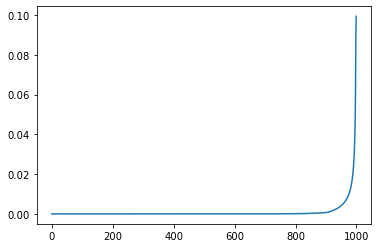

In [ ]:
weights = torch.randn(1000).pow(8)

weights = paretto_smoothed_weights(weights)
weights = weights/weights.sum()
plt.plot(weights.sort()[0])

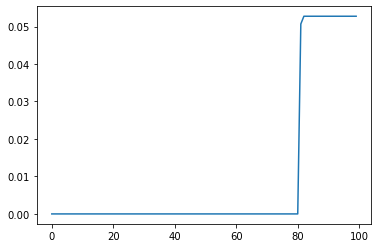

In [ ]:

x = paretto_smoothed_weights(x)
vals, _ = x.softmax(0).sort()
plt.plot(vals)

In [16]:
posterior = inf.build_posterior(flow="spline_autoregressive")
posterior.set_default_x(task.get_observation(1))

VariationalPosterior(
               method_family=snle,
               net=<a Flow, see `.net` for details>,
               prior=Independent(Uniform(low: torch.Size([5]), high: torch.Size([5])), 1),
               x_shape=torch.Size([1, 8]))
               

In [13]:
torch.binomial(torch.tensor([10.]), torch.tensor([0.1]))

tensor([1.])

In [17]:
posterior.train(loss="forward_kl", proposal="q", is_method="clamped")

Loss: 3.58 Std: 0.32:  18%|█▊        | 356/2000 [00:54<04:11,  6.53it/s]



Converged with loss: 3.58
Quality Score: 0.555 (smaller values are good, should be below 1)


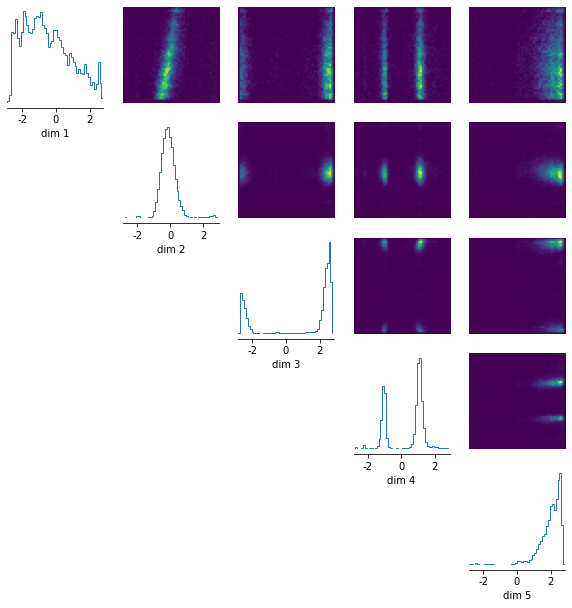

In [18]:
samples = posterior.sample((10000,), method="naive")
_ = pairplot(samples)

In [215]:
optimizer = posterior._optimizer
loss = []
steps = 1000
window = 20
moving_average = np.zeros(steps)
moving_std = np.zeros(steps)
moving_slope = np.ones(steps)
for i in range(steps):
    l = optimizer.step(task.get_observation(1)).numpy()
    optimizer = posterior._optimizer
    if not np.isfinite(l):
        l = loss[-1]
    if i == 0:
        moving_average[i] = l 
    else:
        moving_average[i] = moving_average[i-1] + (l - loss[max(i-window,0)])/window
        moving_std[i] = moving_std[i-1] + (l - loss[max(i-window,0)])/window - moving_std[i-1]/(window-1)
        moving_slope[i] = (l-moving_average[max(i-window,0)])/(window) 

    loss.append(l)

KeyboardInterrupt: 

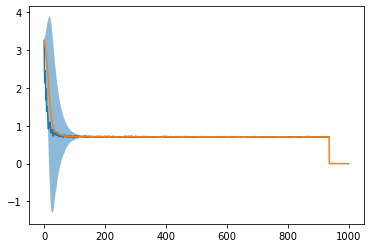

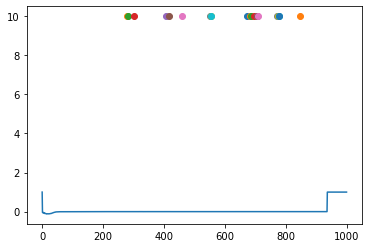

In [216]:
plt.plot(loss)
plt.plot(moving_average)
plt.fill_between(range(steps), moving_average-2*moving_std, moving_average + 2*moving_std, alpha=0.5)
plt.show()
plt.plot(moving_slope)
for i in range(100, steps):
    c = moving_slope[i-100:i].mean()
    if np.abs(c) < 1e-6:
        plt.plot(i,10, "o")

(<Figure size 720x720 with 4 Axes>,
 array([[<AxesSubplot:xlabel='dim 1'>, <AxesSubplot:>],
        [<AxesSubplot:>, <AxesSubplot:xlabel='dim 2'>]], dtype=object))

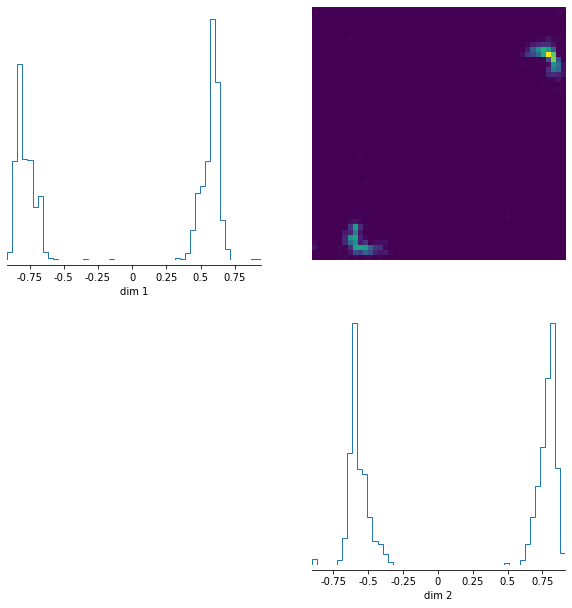

In [217]:
samples = posterior.sample((1000,))
pairplot(samples)

In [605]:
from pyro.distributions.transforms import NeuralAutoregressive, planar, neural_autoregressive
from pyro.nn import AutoRegressiveNN 

arn = AutoRegressiveNN(2, [3*4+1], param_dims=[16] * 3)
transform =  NeuralAutoregressive(arn, hidden_units=16, activation="sigmoid")

In [47]:
def newton_root_finding(f, x,num_steps=5):
    x.requires_grad=True
    for _ in range(num_steps):
        y = f(x)
        y.sum().backward(retain_graph=True)
        x.data -= (y/x.grad).data
        x.grad.data.zero_() 

In [353]:
def bisection_root_finding(f,lower,upper,num_steps=100, tol=1e-5):
    assert lower*upper < 0
    for _ in range(num_steps):
        m = (lower + upper)/2
        print(m)
        if f(lower)*f(m) > 0:
            lower = m 
        else:
            upper = m
            
    return m


In [425]:
x = torch.ones(2)*10
y = transform(x)
print(x)
print(y)
f = lambda t: transform(t)-y

tensor([10., 10.])
tensor([6.9273, 3.7849], grad_fn=<SubBackward0>)


In [576]:
transform = planar(2)

In [696]:
from scipy.optimize import fsolve
def _inverse(self, y):
    with torch.no_grad():
        shape = y.shape
        def f(x):
            x = torch.from_numpy(x).reshape(shape).float()
            return (self(x) - y).flatten().numpy()
     
        x = torch.tensor(fsolve(f, np.zeros(shape).flatten(), xtol=1e-5)).float()
    x = x.reshape(shape)

    return x

In [734]:
def _inverse_batched(self, y, batch_size=20):
    shape = y.shape
    xs = []
    y = y.reshape(-1, y.shape[-1])
    for i in range(batch_size,len(y) + batch_size, batch_size):
        y_i = y[i-batch_size:i,:]
        x_i = _inverse(self,y_i)
        xs.append(x_i)
    x = torch.stack(xs).reshape(shape)

    return x

In [736]:
%%timeit
x = torch.randn(500,2)
y = transform1(x)
x_rec = _inverse_batched(transform1, y, batch_size=20) 
torch.sum(x_rec -x)

515 ms ± 42.9 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [659]:
transform1 = neural_autoregressive(2)
transform2 = neural_autoregressive(2)
transform1._inverse = lambda x: _inverse(transform1, x)
transform2._inverse = lambda x: _inverse(transform2, x)

In [660]:
q = torch.distributions.TransformedDistribution(torch.distributions.MultivariateNormal(torch.zeros(2), torch.eye(2)), [transform1,transform2])

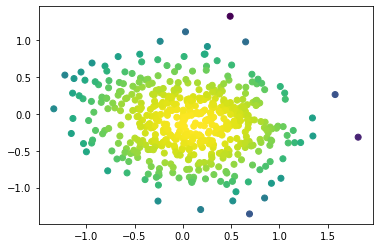

In [661]:
x = q.sample((500,))
logp = q.log_prob(x)
plt.scatter(x.detach()[:,0], x.detach()[:,1], c=logp.detach())

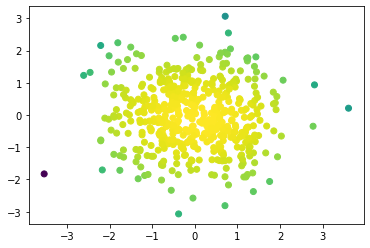

In [664]:
x += 0.01
q.clear_cache()
x = torch.randn((500,2))
logp = q.log_prob(x)
#logp =torch.clamp(logp, logp.quantile(0.01),logp.quantile(0.99))
plt.scatter(x.detach()[:,0], x.detach()[:,1], c=logp.detach())

posterior.q.parameters()

In [5]:
posterior.train(loss="elbo")

Loss: tensor(24321.4492):   2%|▏         | 42/2000 [00:00<00:40, 47.86it/s]c:\users\manug\onedrive\uni\master thesis\sbi\sbi\vi\divergence_optimizers.py:222: FutureWarning: Non-finite norm encountered in torch.nn.utils.clip_grad_norm_; continuing anyway. Note that the default behavior will change in a future release to error out if a non-finite total norm is encountered. At that point, setting error_if_nonfinite=false will be required to retain the old behavior.
  nn.utils.clip_grad_norm_(
Loss: tensor(24.8300):  50%|████▉     | 999/2000 [00:20<00:20, 48.84it/s]


Converged with loss: 24.829999923706055
Quality Score: 0.194 (smaller values are good, should be below 0.7, mode collapse may still occured.)


In [6]:
samples = posterior.sample((10000,))

(<Figure size 720x720 with 16 Axes>,
 array([[<AxesSubplot:xlabel='dim 1'>, <AxesSubplot:>, <AxesSubplot:>,
         <AxesSubplot:>],
        [<AxesSubplot:>, <AxesSubplot:xlabel='dim 2'>, <AxesSubplot:>,
         <AxesSubplot:>],
        [<AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:xlabel='dim 3'>,
         <AxesSubplot:>],
        [<AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>,
         <AxesSubplot:xlabel='dim 4'>]], dtype=object))

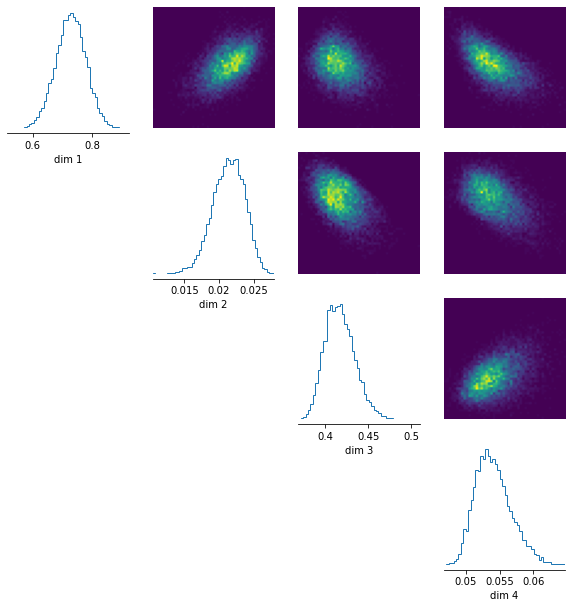

In [7]:
pairplot(samples)

In [34]:
c2st(samples, task.get_reference_posterior_samples(1))

tensor([0.8007])

In [23]:
mcmc_samples = np.load("samples/samples_mcmc_slcp.npy")
c2st(torch.tensor(mcmc_samples), task.get_reference_posterior_samples(1))

tensor([0.7942])

(<Figure size 720x720 with 25 Axes>,
 array([[<AxesSubplot:xlabel='dim 1'>, <AxesSubplot:>, <AxesSubplot:>,
         <AxesSubplot:>, <AxesSubplot:>],
        [<AxesSubplot:>, <AxesSubplot:xlabel='dim 2'>, <AxesSubplot:>,
         <AxesSubplot:>, <AxesSubplot:>],
        [<AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:xlabel='dim 3'>,
         <AxesSubplot:>, <AxesSubplot:>],
        [<AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>,
         <AxesSubplot:xlabel='dim 4'>, <AxesSubplot:>],
        [<AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>,
         <AxesSubplot:xlabel='dim 5'>]], dtype=object))

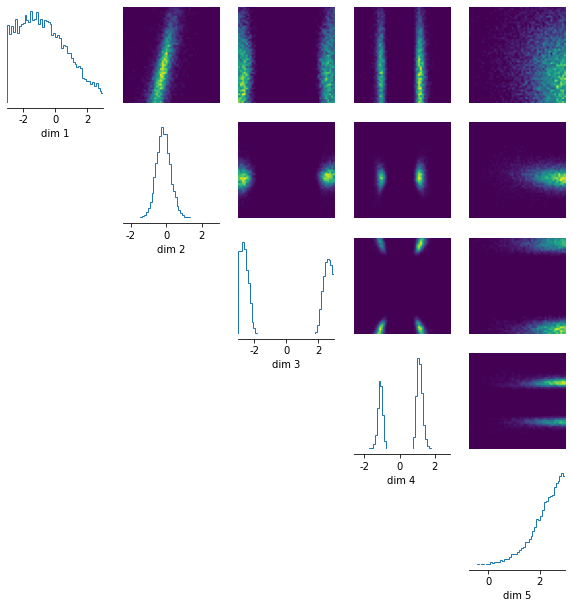

In [32]:
pairplot(mcmc_samples)

In [5]:
x_obs = task.get_observation(6)

In [11]:
posterior.train(loss="iwelbo", max_num_iters=500, n_particles=123, K=32, reduce_variance=True)

Loss: 0.71:  10%|▉         | 48/500 [00:19<03:03,  2.46it/s]


KeyboardInterrupt: 

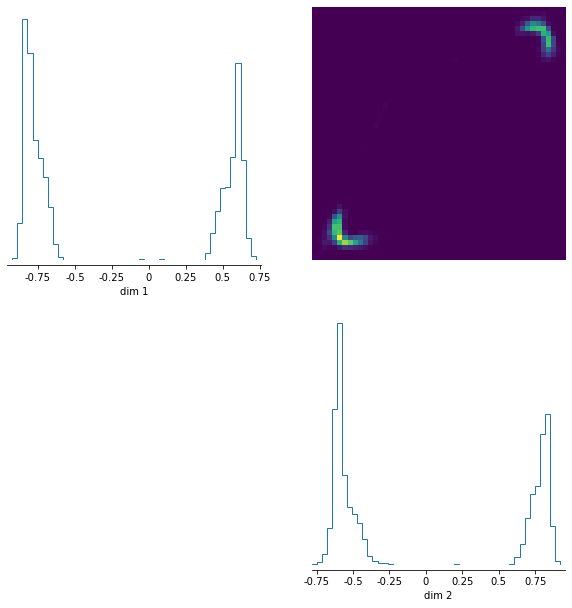

In [7]:
mcmc_samples = np.load("samples/samples_mcmc_two_moons.npy")
_ = pairplot(samples)

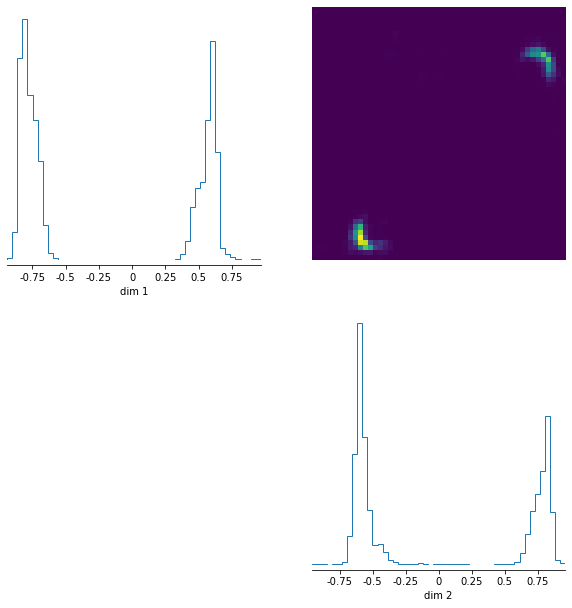

In [7]:
samples = posterior.sample((10000,))
_ = pairplot(samples)

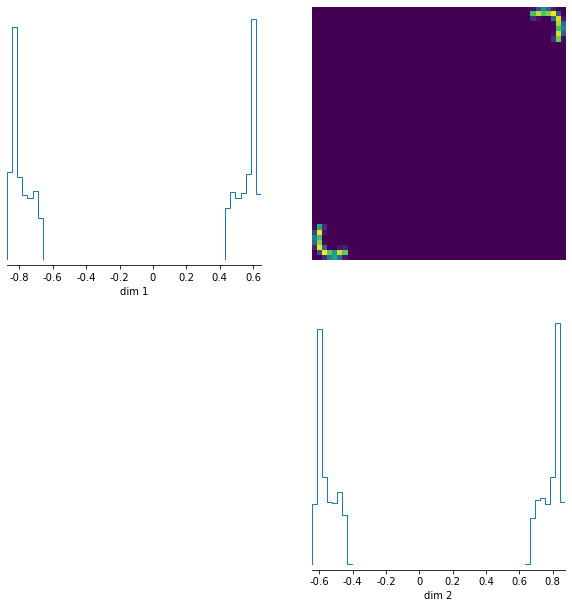

In [10]:
ref_samples = task.get_reference_posterior_samples(1)
_ = pairplot(ref_samples)

In [77]:
samples_bad = posterior.sample((10000,), method="naive")
samples_k8 = posterior.sample((10000,), method="ir", method_params={"K":8})
samples_k16 = posterior.sample((10000,), method="ir", method_params={"K":16})
samples_k64 = posterior.sample((10000,), method="ir", method_params={"K":64})
samples_k128 = posterior.sample((10000,), method="ir", method_params={"K":128})

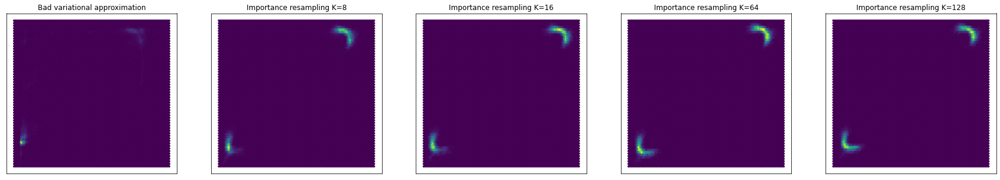

In [83]:
fig, axes = plt.subplots(1, 5, figsize=(30,5)) 
axes[0].hexbin(samples_bad[:,0], samples_bad[:,1])
axes[0].set_title("Bad variational approximation")
axes[1].hexbin(samples_k8[:,0], samples_k8[:,1])
axes[1].set_title("Importance resampling K=8")
axes[2].hexbin(samples_k16[:,0], samples_k16[:,1])
axes[2].set_title("Importance resampling K=16")
axes[3].hexbin(samples_k64[:,0], samples_k64[:,1])
axes[3].set_title("Importance resampling K=64")
axes[4].hexbin(samples_k128[:,0], samples_k128[:,1])
axes[4].set_title("Importance resampling K=128")

for i in range(5):
    axes[i].get_xaxis().set_visible(False)
    axes[i].get_yaxis().set_visible(False)
fig.savefig("importance_resampling_correction.pdf")

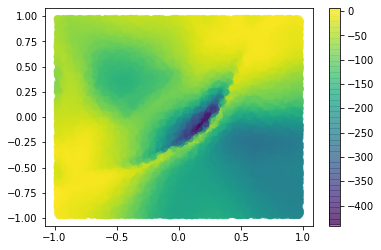

In [249]:
thetas = posterior._prior.sample((50000,))
# Boudnary
max_theta = thetas.max()
min_theta = thetas.min()
mask = torch.logical_and((thetas <= max_theta-0.02), (thetas >= min_theta + 0.02)).sum(1) == thetas.shape[-1]
logratio = posterior.net.log_prob(x_obs.repeat((mask.sum(), 1)), thetas[mask]) + posterior._prior.log_prob(thetas[mask]) - posterior.log_prob(thetas[mask])

plt.scatter(thetas[mask,0], thetas[mask,1], c=logratio.detach(), alpha=0.5)
plt.colorbar()

In [247]:
logratio.max().exp()

tensor(1.5380e+18, grad_fn=<ExpBackward>)

In [80]:
def rejection_sampling(num_samples, num_samples_batch=10000, M_method="mc", maxM=15):
    final_samples = []
    current_samples = 0
    obs = x_obs.repeat((num_samples_batch, 1))
    if M_method == "sgd":
        theta = torch.rand((1,2), requires_grad=True)
        logratio = lambda theta: posterior.net.log_prob(x_obs, theta) + posterior._prior.log_prob(theta) - posterior.log_prob(theta)
        optimizer = torch.optim.Adam([theta],lr=5e-3)
        converged = False
        loss = torch.zeros(1)
        while not converged:
            optimizer.zero_grad()
            old_loss = loss.clone().detach()
            loss = -logratio(theta)
            loss.backward()
            optimizer.step()
            converged = torch.norm(old_loss - loss.detach()) <= 0.00001
        M = logratio(theta)
        print(M.exp())
        print(theta.detach())
    elif M_method == "mc":
        thetas = posterior._prior.sample((100000,))
        # Boudnary
        max_theta = thetas.max()
        min_theta = thetas.min()
        mask = torch.logical_and((thetas <= max_theta - 0.1), (thetas >= min_theta + 0.1)).sum(1) == thetas.shape[-1]
        logratio = posterior.net.log_prob(x_obs.repeat((mask.sum(), 1)), thetas[mask]) + posterior._prior.log_prob(thetas[mask]) - posterior.log_prob(thetas[mask])
        print(thetas[logratio.argmax()])
        M = logratio.max()
        print(M.exp())
    
    while current_samples <= num_samples:
        samples = posterior.sample((num_samples_batch,)) 
        u = torch.rand((num_samples_batch,))
        logp = posterior.net.log_prob(obs, samples) + posterior._prior.log_prob(samples)
        logq = posterior.log_prob(samples,) + min(M, np.log(maxM))
        r = torch.exp(logp-logq)
        mask = u < r 
        final_samples.append(samples[mask])
        current_samples += mask.sum()
    return torch.vstack(final_samples)

In [89]:
samples = rejection_sampling(5000, M_method="sgd", maxM=500)

tensor([270.7994], grad_fn=<ExpBackward>)
tensor([[0.6091, 0.7603]])


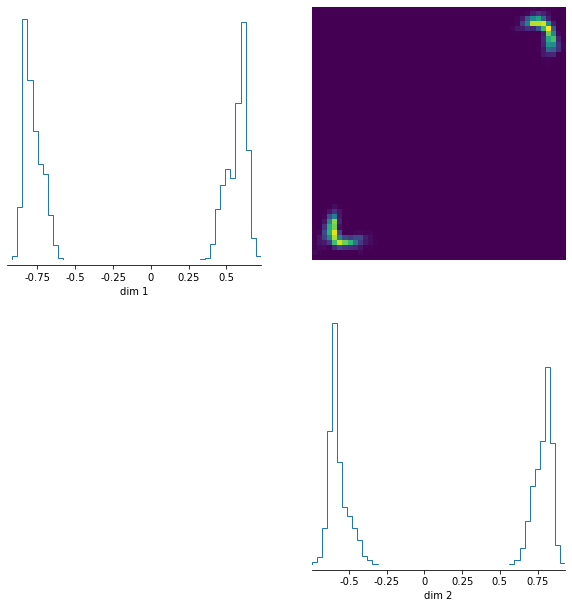

In [90]:
_ = pairplot(samples)

In [33]:
def independent_mh(num_samples, T, num_samples_batch=1000):
    final_samples = []
    samples = posterior.sample((num_samples_batch,))
    obs = x_obs.repeat(num_samples_batch,1)
    sampling_steps = int(T/int(num_samples/num_samples_batch))
    for t in range(T):
        potential_function = posterior.net.log_prob(obs, samples) + posterior._prior.log_prob(samples) - posterior.log_prob(samples)
        new_samples = posterior.sample((num_samples_batch,))
        new_potential_function = posterior.net.log_prob(obs, new_samples) + posterior._prior.log_prob(new_samples) - posterior.log_prob(new_samples)
        acceptance_probability = torch.exp(new_potential_function - potential_function)
        u = torch.rand(num_samples_batch)
        mask = u <= acceptance_probability
        samples[mask] = new_samples[mask]
        if (sampling_steps % (t+1)) == 0:
            final_samples.append(samples)
    return torch.vstack(final_samples)

In [7]:
from sbi.vi.paretto_smoothed_is import GerneralizedParetto, gpdfit, paretto_smoothed_weights, clamp_weights
import matplotlib.pyplot as plt
import torch

In [14]:
p = GerneralizedParetto(0,1,0.6)

In [8]:
samples = posterior.sample((10000,))

In [9]:
logweights = posterior.net.log_prob(x_obs.repeat(10000,1), samples) + posterior._prior.log_prob(samples) - posterior.log_prob(samples)

In [10]:
weights = logweights.exp()
weights /= weights.sum()

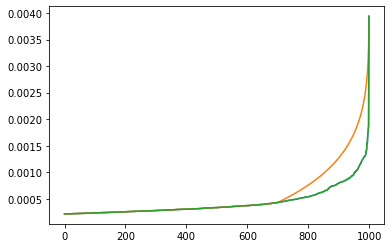

In [12]:
plt.plot(weights.detach().sort()[0][-1000:])
plt.plot(paretto_smoothed_weights(weights.detach()).sort()[0][-1000:])
plt.plot(clamp_weights(weights.detach()).sort()[0][-1000:])

In [79]:
samples = torch.softmax(samples - samples.max(),0)

In [10]:
p = GerneralizedParetto(mu,sigma,k)

In [11]:
z = p.inv_cdf((torch.arange(1,3001)-0.5)/3000)


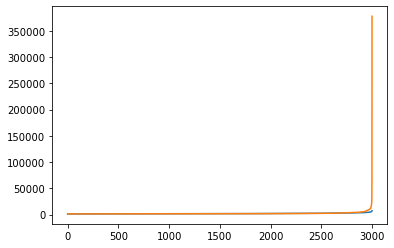

In [12]:
plt.plot(z)
plt.plot(s)

In [39]:
gpdfit(s)

(tensor(-0.7930), tensor(0.0081))

In [4]:
samples = p.sample((10000,))

In [5]:
gpdfit(samples, sorted=True)

(tensor(0.0005), tensor(nan))

In [6]:
def cdf(x,mu, scale, k):
    return 1-(1+ (k*(x-mu))/scale)**(-1/k)
def pdf(x,mu, scale, k):
    return 1/scale*(1+(k*(x-mu))/scale)**(-1/k-1)
def inv_cdf(x,mu,scale,k):
    return mu + scale/k*()

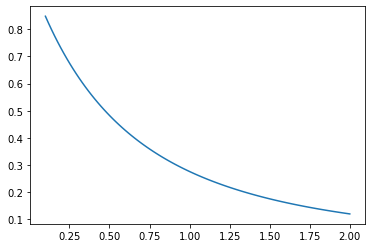

In [7]:
x = torch.linspace(0.1,2)
plt.plot(x,p.log_prob(x).exp())

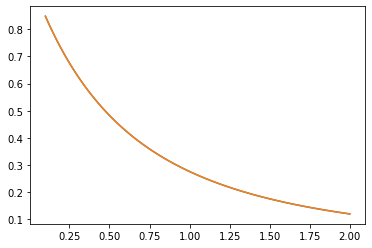

In [8]:
x = torch.linspace(0.1,2)
plt.plot(x,p.log_prob(x).exp())
plt.plot(x,pdf(x,0,1,0.7))
#plt.hist(samples.numpy(), bins=100,density=True)

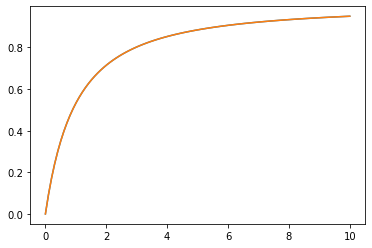

In [13]:
x = torch.linspace(0.001,10)
U = p.cdf(x)
plt.plot(x,U)
plt.plot(x,cdf(x,0,1,0.7))

In [111]:
def random_direction_slice_sampler(num_samples, T, num_samples_batch=1000):
    final_samples = []
    samples = posterior.sample((num_samples_batch,))
    obs = x_obs.repeat(num_samples_batch,1)
    steps = 0.005
    for t in range(T):
        potential_function = posterior.net.log_prob(obs, samples) + posterior._prior.log_prob(samples) 
        y = torch.rand(num_samples)*potential_function.exp()

        random_directions = torch.randn(samples.shape)
        random_directions /= torch.linalg.norm(random_directions,dim=-1).unsqueeze(-1)
        lb = torch.zeros((num_samples_batch,))      
        ub = torch.zeros((num_samples_batch,))  
        mask_lb = (y < potential_function.exp())
        mask_ub = mask_lb.clone()
        while mask_lb.any() and mask_ub.any():
            lb[mask_lb] -= steps 
            ub[mask_ub] += steps
            proposed_samples_lb = samples[mask_lb,:] + lb[mask_lb].unsqueeze(-1)*random_directions[mask_lb,:]
            proposed_samples_ub = samples[mask_ub,:] + ub[mask_ub].unsqueeze(-1)*random_directions[mask_ub,:]

            potential_function_lb = posterior.net.log_prob(obs[mask_lb], proposed_samples_lb) + posterior._prior.log_prob(proposed_samples_lb)
            potential_function_ub = posterior.net.log_prob(obs[mask_ub], proposed_samples_ub) + posterior._prior.log_prob(proposed_samples_ub)

            mask_lb[mask_lb] = y[mask_lb] < potential_function_lb.exp()
            mask_ub[mask_ub] = y[mask_ub] < potential_function_ub.exp()
        x = torch.rand(num_samples)*(ub-lb) + lb 
        samples = samples + x.unsqueeze(-1)*random_directions
    return samples
        

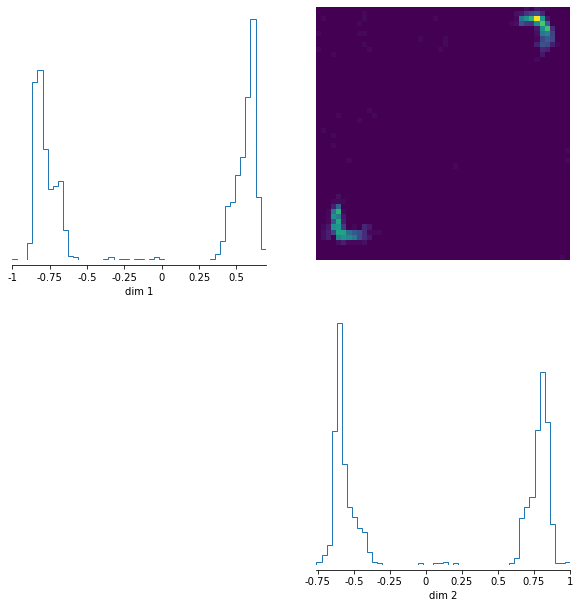

In [112]:
samples = random_direction_slice_sampler(1000, 20)
_ = pairplot(samples)

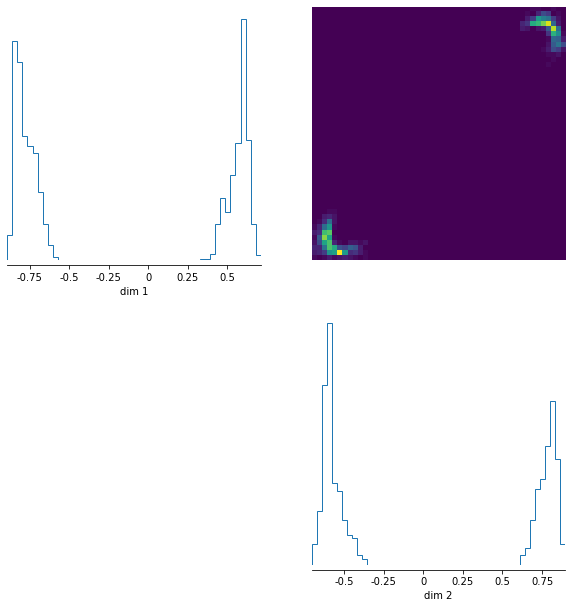

In [35]:
samples = independent_mh(5000, 50)
_ = pairplot(samples)

In [8]:
two_moons_sim = task.get_simulator()

Epsilon quantile:  tensor(0.0461)
Accepted samples:  455
Epsilon quantile:  tensor(0.0470)
Accepted samples:  912


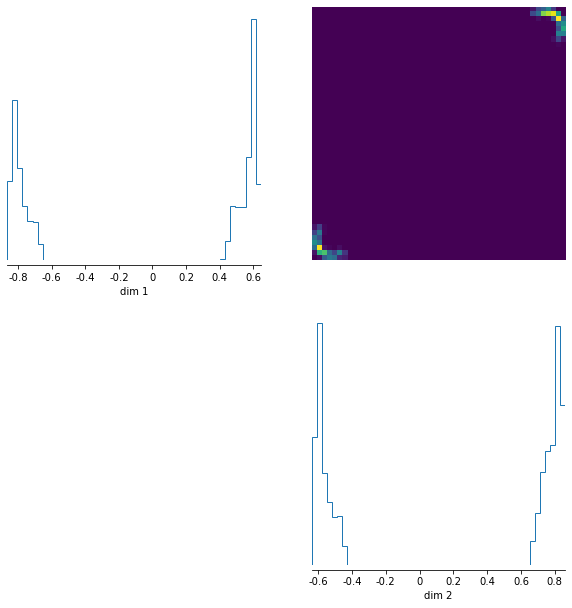

In [25]:
from sbi.vi.paretto_smoothed_is import abc_rejection, abc_slice_mcmc
samples = abc_rejection(900, posterior, x_obs, epsilon=0.25, min_samples_accept=10, pca_statistic=True, statistic_dim=2, simulator=two_moons_sim, verbose=True, num_samples_batch=5000)
_ = pairplot(samples)

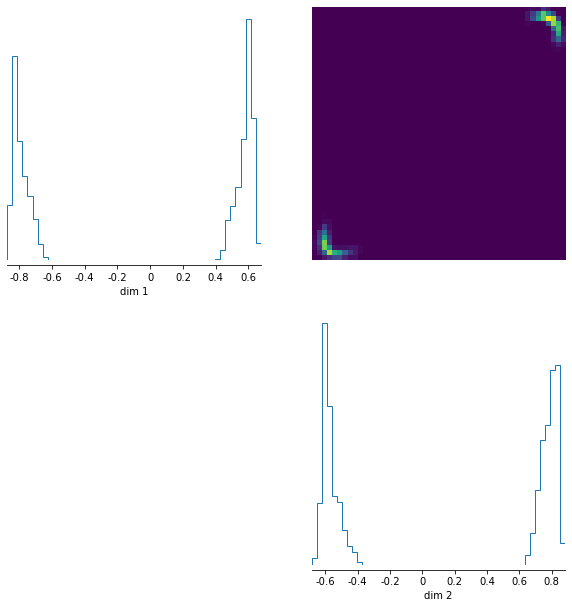

In [40]:
samples = abc_rejection(2000, posterior, x_obs, epsilon=0.25, min_samples_accept=10, pca_statistic=False, simulator=None, verbose=False, num_samples_batch=5000)
_ = pairplot(samples)

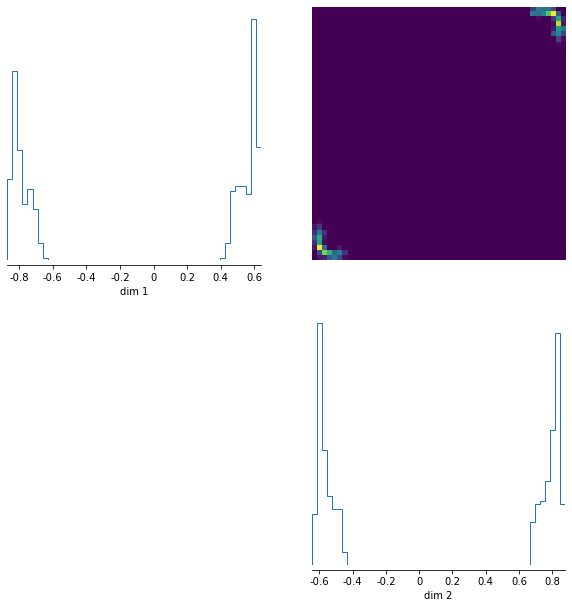

In [37]:
samples = abc_slice_mcmc(1000, posterior, x_obs,two_moons_sim, epsilon=0.25 , T=20, min_samples_accept=50)
_ = pairplot(samples)

In [10]:
two_moons_sim = task.get_simulator()

In [28]:
samples = torch.randn((100,8))

In [67]:
# Random projections 
eps = 0.1
k = (np.log(1000) * 8)/(eps**2)
k

5526.2042231857085

In [75]:
def abc_correction(simulator, epsilon = 0.1, statistic = lambda x: x, num_samples = 50000):
    #samples = posterior.sample((num_samples,))
    samples = importance_resampling(32, num_samples)
    data = simulator(samples)
    data_m = data.mean(0)
    data_std = data.std(0)
    normed_data = (data-data_m)/data_std
    stats_simulated = statistic(normed_data)
    stats_observed = statistic((x_obs - data_m)/data_std)
    stats_mean = stats_simulated.mean(0)
    stats_std = stats_simulated.std(0)
    stats_simulated = (stats_simulated - stats_mean)/stats_std
    stats_observed = (stats_observed - stats_mean)/stats_std
    dist = torch.linalg.norm(stats_simulated-stats_observed, dim=-1)
    mask = dist <= epsilon
    print("Accepted", mask.sum()/num_samples)
    return samples[mask]

In [15]:
def abc_mcmc(T,simulator, epsilon = 0.1, num_samples=100):
    samples = posterior.sample((num_samples,))
    obs = x_obs.repeat(num_samples,1)
    scale = 0.5
    for t in range(T):
        logp1 = posterior.net.log_prob(obs, samples) + posterior._prior.log_prob(samples) 
        proposal = torch.distributions.MultivariateNormal(samples, scale*torch.eye(samples.shape[-1]))
        proposed_samples = proposal.sample()
        logp2 = posterior.net.log_prob(obs, proposed_samples) + posterior._prior.log_prob(proposed_samples) 
        u = torch.rand(num_samples)
        mask = u <= torch.exp(logp2-logp1)
        #data = simulator(proposed_samples[mask])
        data = posterior.net.sample(1,proposed_samples[mask]).squeeze()
        dist = torch.linalg.norm(data-x_obs, dim=-1)
        mask[mask] = (dist <= epsilon)
        print("Accepted: ", mask.sum())
        samples[mask] = proposed_samples[mask]
        if t % 10:
            scale *= 0.99
    return samples

In [838]:
likelihood = posterior.net
prior = posterior._prior

In [19]:
def abc_slice_mcmc(T,simulator=None, epsilon = 0.1, num_samples=100, SIR=True):
    abc_samples = []
    num_simulations = 0
    if not SIR:
        samples = posterior.sample((num_samples,))
    else:
        samples = importance_resampling(64, num_samples)
    obs = x_obs.repeat(num_samples,1)
    steps = 0.01
    for t in range(T):
        dim = samples.shape[-1]
        idx = torch.randint(dim,(1,))
        y = torch.rand(num_samples)*torch.exp(posterior.net.log_prob(obs, samples) + posterior._prior.log_prob(samples))

        lb = samples[:,idx] 
        ub = samples[:,idx] 
        samples[:,idx] = lb
        log_prob =  posterior.net.log_prob(obs, samples) + posterior._prior.log_prob(samples)
        mask = (y < log_prob.exp())
        while mask.any():
            lb[mask] -= steps 
            samples[mask,idx] = lb[mask].squeeze()
            log_prob = posterior.net.log_prob(obs[mask], samples[mask]) + posterior._prior.log_prob(samples[mask])
            mask[mask] = y[mask] < log_prob.exp()
        samples[:,idx] = ub
        log_prob =  posterior.net.log_prob(obs, samples) + posterior._prior.log_prob(samples)
        mask = (y < log_prob.exp())
        while mask.any():
            ub[mask] += steps 
            samples[mask,idx] = ub[mask].squeeze()
            log_prob = posterior.net.log_prob(obs[mask], samples[mask])+ posterior._prior.log_prob(samples[mask])
            mask[mask] = y[mask] < log_prob.exp()
        print(lb[0],ub[0])
        x = torch.rand(num_samples,1)*(ub-lb) + lb 
        samples[:,idx] = x 
        if simulator is not None and t >= int(T/2):
            num_simulations += len(samples)
            print(num_simulations)
            data = simulator(samples)
            data_m = data.mean(0)
            data_std = data.std(0)
            normed_data = (data-data_m)/data_std
            U = torch.pca_lowrank(normed_data)[-1][:,:2]
            data_statistic = torch.matmul(data, U)
            observed_statistic = torch.matmul(x_obs, U)
            dist = torch.linalg.norm(data_statistic-observed_statistic, dim=-1)
            adap_epsilon = dist.quantile(0.05)
            mask = dist <= max(epsilon, adap_epsilon)
            abc_samples.append(samples[mask].clone())

    return samples, torch.vstack(abc_samples)

In [26]:
samples = abc_slice_mcmc(10, two_moons_sim, epsilon=0.02, num_samples=2000)

tensor([-0.6234]) tensor([-0.4334])
tensor([-0.8532]) tensor([-0.8132])
tensor([-0.7146]) tensor([-0.3746])
tensor([-0.6317]) tensor([-0.4017])
tensor([-0.8589]) tensor([-0.7989])
tensor([-0.6890]) tensor([-0.3790])
2000
tensor([-0.8742]) tensor([-0.6142])
4000
tensor([-0.8624]) tensor([-0.7824])
6000
tensor([-0.8511]) tensor([-0.8011])
8000
tensor([-0.8485]) tensor([-0.7985])
10000


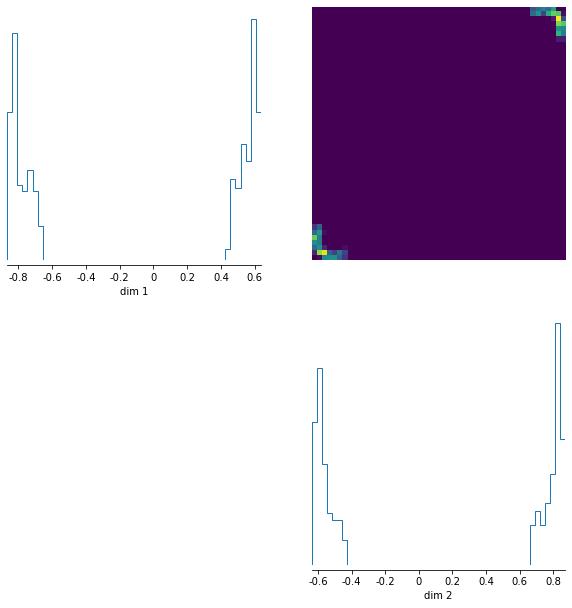

In [28]:
_ = pairplot(samples[1])

In [340]:
def abc_surrogate_correction(epsilon = 0.1,statistic = lambda x: x, num_samples = 50000):
    samples = posterior.sample((num_samples,))
    data = posterior.net.sample(1,samples).squeeze()
    data_m = data.mean(0)
    data_std = data.std(0)
    normed_data = (data-data_m)/data_std
    stats_simulated = statistic(normed_data)
    stats_observed = statistic((x_obs - data_m)/data_std)
    stats_mean = stats_simulated.mean(0)
    stats_std = stats_simulated.std(0)
    stats_simulated = (stats_simulated - stats_mean)/stats_std
    stats_observed = (stats_observed - stats_mean)/stats_std
    dist = torch.linalg.norm(stats_simulated-stats_observed, dim=-1)
    mask = dist <= epsilon
    print("Accepted", mask.sum()/num_samples)
    return samples[mask]

In [341]:
def sequential_abc_surrogate_correction():
    pass

In [21]:
def importance_resampling(K , num_samples = 10000):
    with torch.no_grad():
        obs = x_obs.repeat(K*num_samples,1)
        thetas = posterior.sample((num_samples*K,))
        logp = posterior.net.log_prob(obs, thetas) + posterior._prior.log_prob(thetas) 
        logq = posterior.log_prob(thetas)
        weights = (logp-logq).reshape(num_samples, K).softmax(-1).cumsum(-1)
        u = torch.rand(num_samples, 1)
        mask = torch.cumsum(weights >= u, -1) == 1
        samples = thetas.reshape(num_samples, K, -1)[mask]
    return samples

In [687]:
def importance_resampling(K , num_samples = 10000):
    with torch.no_grad():
        obs = x_obs.repeat(K*num_samples,1)
        samples = posterior.sample((num_samples*K,))
        logp = posterior.net.log_prob(obs, samples) + posterior._prior.log_prob(samples) 
        logq = posterior.log_prob(samples)
        weights = (logp-logq).reshape(num_samples, K).softmax(-1).cumsum(-1)
        idx = torch.multinomial(weights, K, replacement=True)
        samples = samples.reshape(num_samples, K, -1)
        samples = samples[idx]
    return samples[:,:,0,:]

In [316]:
samples = posterior.sample((1000,))
X = two_moons_sim(samples)
R = torch.bernoulli(torch.ones(2,8)*0.5)*2-1
y = (R@X.T*1/np.sqrt(2)).T
dist = torch.cdist(y,y)
dist_org = torch.cdist(X,X)
torch.sum((dist-dist_org)**2)

tensor(42509684.)

In [298]:
k = 1
obs = (x_obs-X.mean(0))/X.std(0)
X = (X-X.mean(0))/X.std(0)
S = X@X.T #+ np.eye(X.shape[0])*1e-4
eval, evec = torch.symeig(S, eigenvectors=True)
V_k = evec[:,-k:]
X_proj = V_k @ torch.diag(eval[-k:]).sqrt()

In [305]:
V_k

tensor([[ 0.1300],
        [ 0.2101],
        [-0.1376],
        [-0.1585],
        [ 0.0387],
        [ 0.2875],
        [-0.3126],
        [-0.0554],
        [-0.0792],
        [-0.0739],
        [-0.0330],
        [-0.2672],
        [-0.2956],
        [-0.0975],
        [-0.1639],
        [-0.2586],
        [ 0.4054],
        [ 0.3613],
        [ 0.3371],
        [ 0.1628]])

In [299]:
torch.cdist(X,obs)

tensor([[2.6733],
        [2.3207],
        [4.7521],
        [4.9922],
        [3.2565],
        [1.7564],
        [5.2681],
        [3.8447],
        [3.4393],
        [3.2573],
        [4.2119],
        [4.9260],
        [5.4582],
        [3.9428],
        [4.4903],
        [4.9027],
        [2.5688],
        [4.5918],
        [3.0576],
        [1.7490]])

In [294]:
torch.cdist(X_proj, X_proj)[0]

tensor([0.0000, 6.2242, 5.7167, 5.1901, 6.7612, 4.8310, 8.7595, 4.5388, 5.1681,
        7.1315, 3.8642, 5.4330, 3.9960, 8.7593, 5.2588, 7.0028, 6.0734, 5.6892,
        7.6273, 6.6347])

In [107]:
from sklearn.random_projection import GaussianRandomProjection
samples = posterior.sample((1000000,))
data = two_moons_sim(samples)
transformer = GaussianRandomProjection(n_components=2, eps=0.00001)
transformer.fit(data)

GaussianRandomProjection(eps=1e-05, n_components=2)

In [113]:
corrected_samples = [] 

for i in range(50):  
    samples = abc_correction(two_moons_sim, 0.05, num_samples=50000, statistic=lambda x: torch.tensor(transformer.transform(x.numpy())))
    corrected_samples.append(samples)
corrected_samples = torch.vstack(corrected_samples)

Accepted tensor(0.0002)
Accepted tensor(0.0002)
Accepted tensor(0.0002)
Accepted tensor(0.0003)
Accepted tensor(0.0002)
Accepted tensor(0.0002)
Accepted tensor(0.0003)
Accepted tensor(0.0002)
Accepted tensor(0.0002)


KeyboardInterrupt: 

In [80]:
corrected_samples = [] 
samples = posterior.sample((10000,))
data = two_moons_sim(samples)
normed_data = (data-data.mean(0))/data.std(0)
U = torch.pca_lowrank(normed_data)[-1][:,:2]

for i in range(10):  
    samples = abc_correction(two_moons_sim, 0.1, num_samples=10000, statistic=lambda x: torch.matmul(x, U))
    corrected_samples.append(samples)
corrected_samples = torch.vstack(corrected_samples)

Accepted tensor(0.0038)


KeyboardInterrupt: 

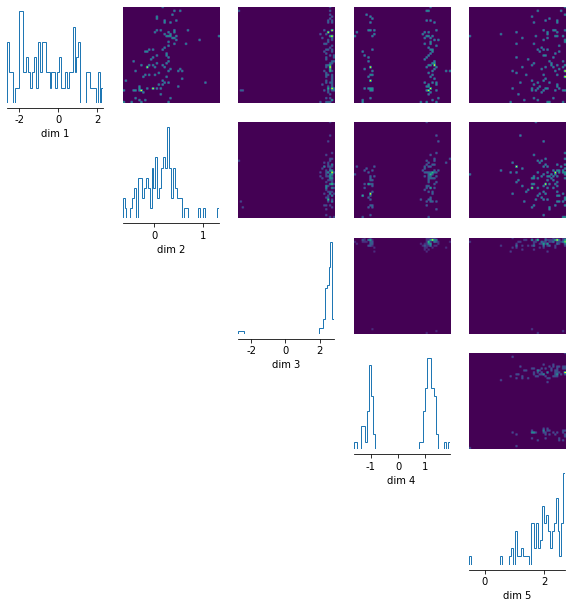

In [112]:
_ = pairplot(corrected_samples)

In [572]:
corrected_samples = [] 
for i in range(20):  
    samples = abc_surrogate_correction(0.01, num_samples=50000, statistic=lambda x: torch.matmul(x, U))
    corrected_samples.append(samples)
corrected_samples = torch.vstack(corrected_samples)

Accepted tensor(0.0004)
Accepted tensor(0.0004)
Accepted tensor(0.0003)
Accepted tensor(0.0005)
Accepted tensor(0.0003)
Accepted tensor(0.0004)
Accepted tensor(0.0004)
Accepted tensor(0.0003)
Accepted tensor(0.0004)
Accepted tensor(0.0004)
Accepted tensor(0.0003)
Accepted tensor(0.0003)
Accepted tensor(0.0002)
Accepted tensor(0.0003)
Accepted tensor(0.0004)
Accepted tensor(0.0004)
Accepted tensor(0.0004)
Accepted tensor(0.0003)
Accepted tensor(0.0002)
Accepted tensor(0.0004)


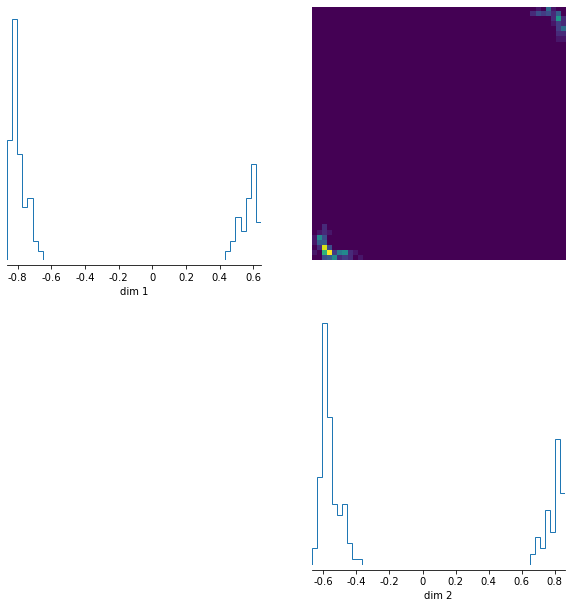

In [569]:
_ = pairplot(corrected_samples)

Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(1)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(1)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(1)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(1)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(0)
Accepted:  tensor(1)
Accepted:  tensor(1)
Accepted:  tensor(0)
Accepted:  te

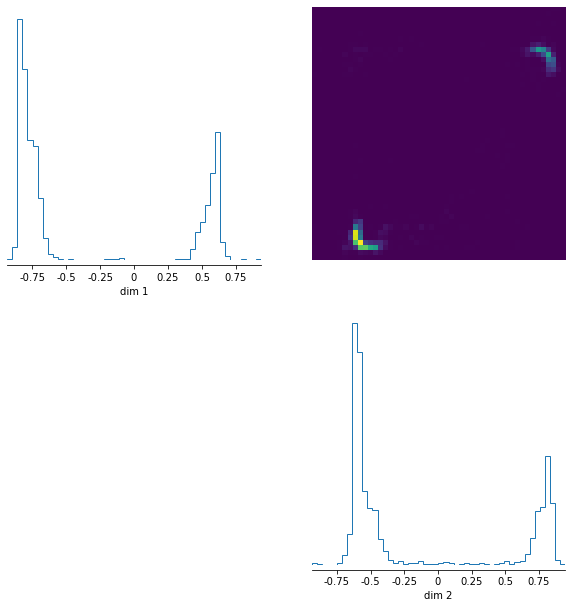

In [570]:
corrected_samples = abc_mcmc(2000, two_moons_sim, epsilon=0.01,num_samples=2000)
_ = pairplot(corrected_samples)

In [826]:
corrected_samples = importance_resampling(256,num_samples=1000)

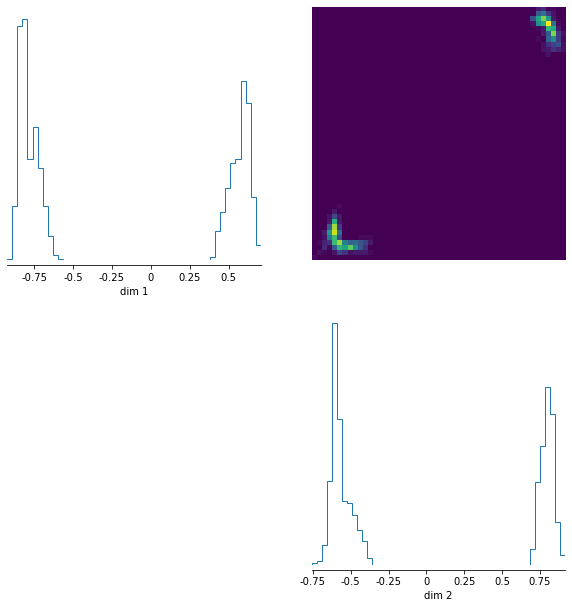

In [827]:
_ = pairplot(corrected_samples)